# Understading JUNO .npz datasets

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from tqdm import tqdm

In [2]:
import modules

# custom modules
%load_ext autoreload
%autoreload 1
%aimport modules.visualize_event 
%aimport modules.convert_pmt_ids

In [56]:
colors = [
    "#fd7f6f",
    "#7eb0d5",
    "#b2e061",
    "#bd7ebe",
    "#ffb55a",
    "#8bd3c7"
]

## Load data

In [3]:
# PMT positions on the sphere
PMTPos_CD_LPMT    = pd.read_csv("../data/PMTPos_CD_LPMT.csv")
# PMT ID mapping
PMT_ID_conversion = pd.read_csv("../data/PMT_ID_conversion.csv")

# EVENTS
train_data        = np.load("../data/real/train/data/raw_data_train_4.npz", allow_pickle=True)["a"]
# TRUE ENERGY AND TRUE VERTEX OF THE EVENTS
train_label       = pd.read_csv("../data/real/train/targets/targets_train_4.csv")

# COMPUTE RADIUS FROM TRUE VERTEX
train_label["edepR"] = (train_label["edepX"]**2 + train_label["edepY"]**2 + train_label["edepZ"]**2)**0.5

### Inspect `train_data`

The shape of the `numpy.array` is

In [4]:
print(train_data.shape)

(3, 5000)


where the first index is the *feature* index

1. PMT ID
2. Charge
3. Hit time

and the second index is the *event* index, i.e. there are $5000$ events recorded.

Note that each *event* contains a variable number of hits! Thus, each entry of the array is an array itself.

Let us convert the `numpy.array` into a `pandas.DataFrame` to better visualize the connection between hits, events and features.

The first preprocess we apply is to remove hits with zero-hit-time, i.e. $ht=0$. 

We iterate over the events and keep only the hits with non-zero hit time: `train_data[2, :][i] != 0.0`.

We also convert the first feature, PMT ID, to a more readable format using the PMT mapping provided, i.e. the `PMT_ID_conversion.csv` file.

In [5]:
NEvents = train_data.shape[1]
for i in tqdm(range(NEvents)):
    # find non-zero-time hits
    nonzeros_inds = np.where(train_data[2, :][i] != 0.0)[0]
    # PMT ID mapping
    train_data[0, :][i] = modules.convert_pmt_ids.convert_pmt_ids(train_data[0, :][i], PMT_ID_conversion)
    # keep only non-zero hits
    train_data[0, :][i] = train_data[0, :][i][nonzeros_inds]
    train_data[1, :][i] = train_data[1, :][i][nonzeros_inds]
    train_data[2, :][i] = train_data[2, :][i][nonzeros_inds]
    
del i

100%|██████████| 5000/5000 [00:02<00:00, 1973.53it/s]


In [6]:
df = pd.DataFrame(train_data.T, columns=("pmt_id", "charge", "hit_time"))
df.head()

,pmt_id,charge,hit_time
0,"[0, 1, 2, 8, 14, 15, 18, 19, 20, 34, 40, 54, 6...","[1.0169096287452863, 1.289895357346751, 1.4573...","[278.5438428571429, 270.03612857142855, 263.31..."
1,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[7.69295220634088, 6.316354197252007, 1.649539...","[204.54384285714283, 224.03612857142858, 225.0..."
2,"[17, 20, 27, 28, 32, 33, 35, 58, 60, 69, 72, 7...","[1.0770311814496256, 1.4405190900405578, 1.112...","[360.4588428571429, 1212.2837, 1169.9381085714..."
3,"[2, 15, 25, 40, 57, 62, 67, 85, 162, 166, 167,...","[1.481666113625243, 1.0454746500116843, 1.4914...","[288.6028228571429, 344.2614142857143, 568.777..."
4,"[9, 11, 19, 31, 37, 38, 43, 49, 51, 54, 60, 76...","[1.1243191985536116, 0.7539582292427174, 1.055...","[338.9815371428572, 499.8719857142857, 187.328..."


The index of the `pandas.dataframe` is the *event id*. Each event holds a number `n_hit` of hits and each hit is characterized by a `pmt_id` (the ID of the PMT that got hit), the collected `charge` and the `hit_time`. Note that the `hit_time` is computed event by event: it is an information to be used "inside" the event.

In [7]:
# add event_id column
df["event_id"] = np.arange(0, df.shape[0], 1)
df = df[["event_id", "pmt_id", "charge", "hit_time"]]  
df

,event_id,pmt_id,charge,hit_time
0,0,"[0, 1, 2, 8, 14, 15, 18, 19, 20, 34, 40, 54, 6...","[1.0169096287452863, 1.289895357346751, 1.4573...","[278.5438428571429, 270.03612857142855, 263.31..."
1,1,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[7.69295220634088, 6.316354197252007, 1.649539...","[204.54384285714283, 224.03612857142858, 225.0..."
2,2,"[17, 20, 27, 28, 32, 33, 35, 58, 60, 69, 72, 7...","[1.0770311814496256, 1.4405190900405578, 1.112...","[360.4588428571429, 1212.2837, 1169.9381085714..."
3,3,"[2, 15, 25, 40, 57, 62, 67, 85, 162, 166, 167,...","[1.481666113625243, 1.0454746500116843, 1.4914...","[288.6028228571429, 344.2614142857143, 568.777..."
4,4,"[9, 11, 19, 31, 37, 38, 43, 49, 51, 54, 60, 76...","[1.1243191985536116, 0.7539582292427174, 1.055...","[338.9815371428572, 499.8719857142857, 187.328..."
...,...,...,...,...
4995,4995,"[0, 10, 17, 20, 21, 24, 38, 63, 70, 74, 94, 95...","[1.3254046656216911, 0.9855646448302391, 0.873...","[647.8295571428571, 284.6588428571428, 238.173..."
4996,4996,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[5.069035289186772, 4.132075984757962, 2.83924...","[227.7504142857143, 222.74568, 213.60310857142..."
4997,4997,"[0, 3, 12, 38, 41, 42, 63, 78, 84, 97, 100, 10...","[1.0725858313803227, 1.1564229012651848, 1.020...","[671.5438428571427, 314.8888228571429, 373.645..."
4998,4998,"[1, 6, 7, 14, 15, 19, 27, 30, 33, 44, 46, 48, ...","[1.1584160901915277, 0.9035373743278005, 0.984...","[127.4647, 354.0911285714285, 376.112128571428..."


Here we expand the `pandas.DataFrame` to make it *hit-wise* instead of event-wise. Events will be tracked using the `event_id` column.

In [8]:
event_list = []
# for each event
for ev in tqdm(df["event_id"]):
    
    # number of hits in the event
    ev_shape = df["pmt_id"][ev].shape[0]
    # store features
    pmt      = df["pmt_id"][ev]
    q        = df["charge"][ev]
    ht       = df["hit_time"][ev]
    # replicate the event id
    ev_id    = [ev] * ev_shape
    
    # build the dataframe
    event_df = pd.DataFrame(np.array([ev_id, pmt, q, ht]).T, columns = ("ev_id", "pmt_id", "charge", "hit_time"))
    
    # store the event
    event_list.append(event_df)

# concatenate all events
data = pd.concat(event_list, ignore_index=True)


# delete for-loop variables
del ev
del event_list
del ev_shape
del pmt
del q
del ht
del ev_id
del event_df

100%|██████████| 5000/5000 [00:01<00:00, 3201.05it/s]


In [9]:
data

,ev_id,pmt_id,charge,hit_time
0,0.0,0.0,1.016910,278.543843
1,0.0,1.0,1.289895,270.036129
2,0.0,2.0,1.457318,263.317109
3,0.0,8.0,0.931422,267.299700
4,0.0,14.0,1.325459,329.878129
...,...,...,...,...
28344454,4999.0,17596.0,1.015088,363.252414
28344455,4999.0,17600.0,0.946382,375.834414
28344456,4999.0,17603.0,0.849958,378.658700
28344457,4999.0,17604.0,1.005972,295.039843


Now, if we need information of entire events, we simply need to use the `pandas.DataFrame.groupby()` function!

For example, let us inspect the number of hits inside each event. To do so, we *group by* the event id and compute the *size* of the output group. Then we make the histogram of such sizes!

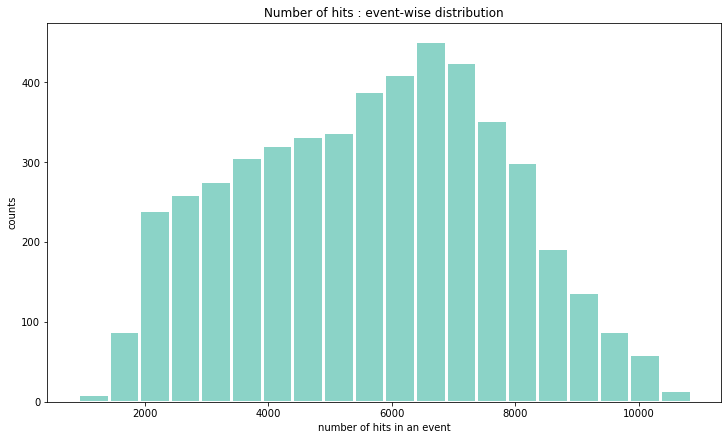

In [109]:
counts = data.groupby("ev_id")\
             .size()\
             .reset_index(name='counts')      


fig, ax = plt.subplots(figsize=(10,6), constrained_layout=True)

ax.hist(
    counts["counts"],
    bins      = 20,
    histtype  = "bar", 
    linewidth = 3,
    edgecolor = "white", 
    facecolor = colors[5], 
    alpha     = 1, 
)

ax.set_title("Number of hits : event-wise distribution")
ax.set_xlabel("number of hits in an event")
ax.set_ylabel("counts")
plt.show()

Before joining hit informations with the PMT mapping on the sphere, let us analyze briefly the feature distributions.

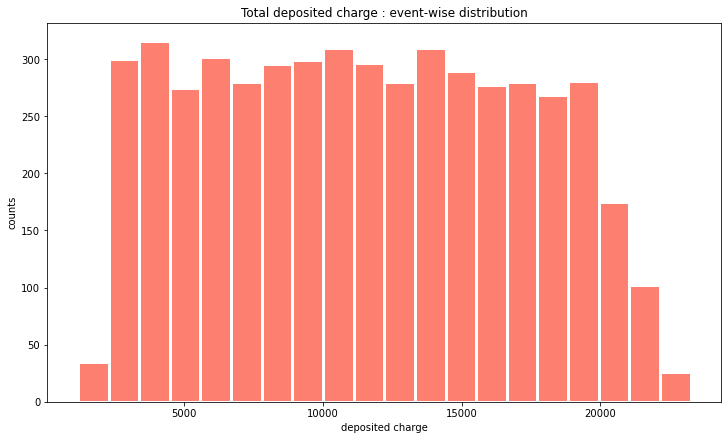

In [110]:
ev_total_features = data.groupby("ev_id")\
                        .sum()\
                        .reset_index()   

fig, ax = plt.subplots(figsize=(10,6), constrained_layout=True)

ax.hist(
    ev_total_features["charge"],
    bins      = 20,
    histtype  = "bar", 
    linewidth = 3,
    edgecolor = "white", 
    facecolor = colors[0], 
    alpha     = 1, 
)

ax.set_title("Total deposited charge : event-wise distribution")
ax.set_xlabel("deposited charge")
ax.set_ylabel("counts")
plt.show()

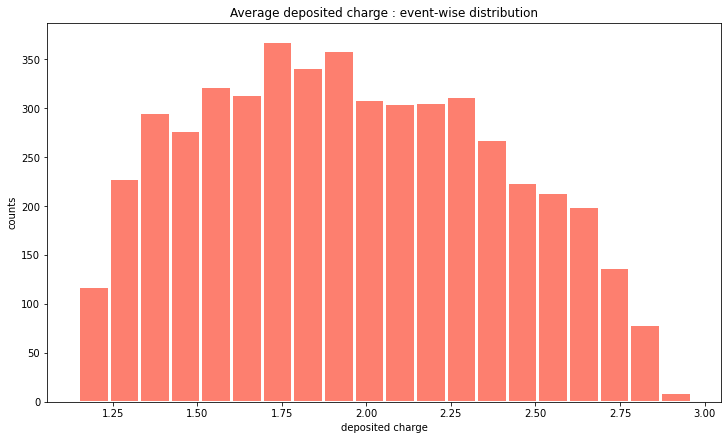

In [111]:
ev_average_features = data.groupby("ev_id")\
                        .mean()\
                        .reset_index()   

fig, ax = plt.subplots(figsize=(10,6), constrained_layout=True)

ax.hist(
    ev_average_features["charge"],
    bins      = 20,
    histtype  = "bar", 
    linewidth = 3,
    edgecolor = "white", 
    facecolor = colors[0], 
    alpha     = 1, 
)

ax.set_title("Average deposited charge : event-wise distribution")
ax.set_xlabel("deposited charge")
ax.set_ylabel("counts")
plt.show()

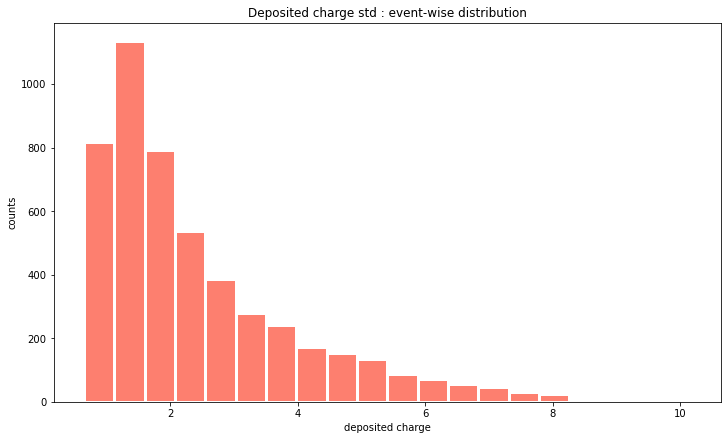

In [112]:
ev_features_std = data.groupby("ev_id")\
                        .std()\
                        .reset_index()   

fig, ax = plt.subplots(figsize=(10,6), constrained_layout=True)

ax.hist(
    ev_features_std["charge"],
    bins      = 20,
    histtype  = "bar", 
    linewidth = 3,
    edgecolor = "white", 
    facecolor = colors[0], 
    alpha     = 1, 
)

ax.set_title("Deposited charge std : event-wise distribution")
ax.set_xlabel("deposited charge")
ax.set_ylabel("counts")
plt.show()

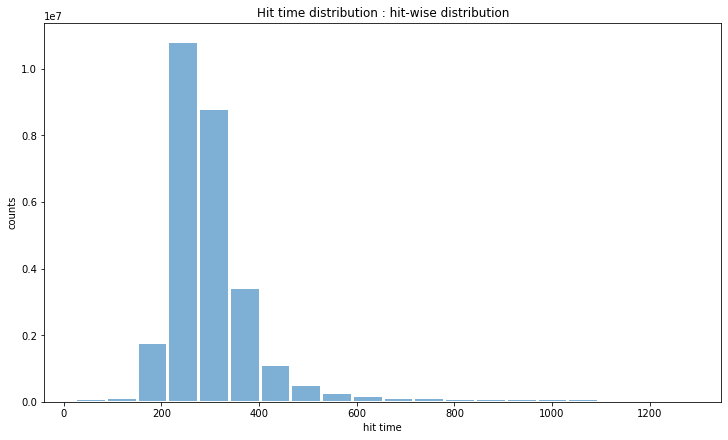

In [93]:
fig, ax = plt.subplots(figsize=(10,6), constrained_layout=True)

ax.hist(
    data["hit_time"],
    bins      = 20,
    histtype  = "bar", 
    linewidth = 3,
    edgecolor = "white", 
    facecolor = colors[1], 
    alpha     = 1, 
)

ax.set_title("Hit time distribution : hit-wise distribution")
ax.set_xlabel("hit time")
ax.set_ylabel("counts")

plt.show()

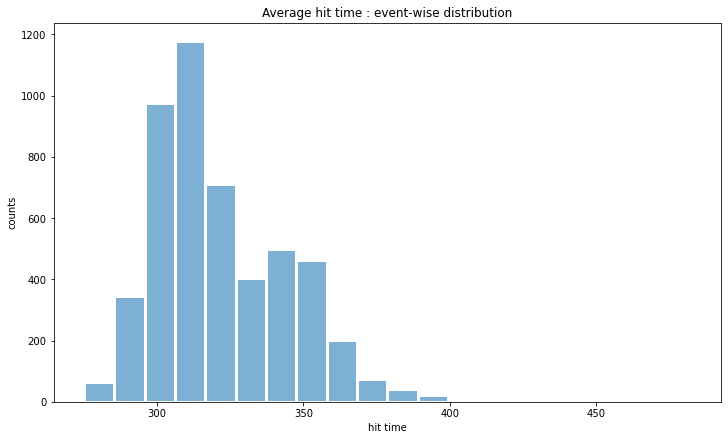

In [97]:
fig, ax = plt.subplots(figsize=(10,6), constrained_layout=True)

ax.hist(
    ev_average_features["hit_time"],
    bins      = 20,
    histtype  = "bar", 
    linewidth = 3,
    edgecolor = "white", 
    facecolor = colors[1], 
    alpha     = 1, 
)

ax.set_title("Average hit time : event-wise distribution")
ax.set_xlabel("hit time")
ax.set_ylabel("counts")
plt.show()

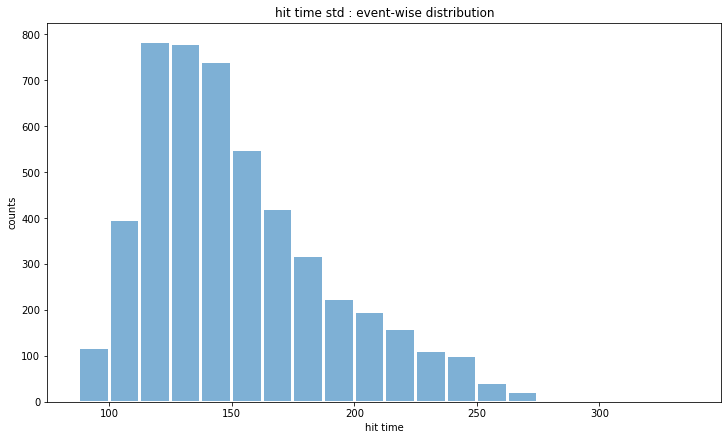

In [99]:
fig, ax = plt.subplots(figsize=(10,6), constrained_layout=True)

ax.hist(
    ev_features_std["hit_time"],
    bins      = 20,
    histtype  = "bar", 
    linewidth = 3,
    edgecolor = "white", 
    facecolor = colors[1], 
    alpha     = 1, 
)

ax.set_title("hit time std : event-wise distribution")
ax.set_xlabel("hit time")
ax.set_ylabel("counts")
plt.show()

In [100]:
data

,ev_id,pmt_id,charge,hit_time
0,0.0,0.0,1.016910,278.543843
1,0.0,1.0,1.289895,270.036129
2,0.0,2.0,1.457318,263.317109
3,0.0,8.0,0.931422,267.299700
4,0.0,14.0,1.325459,329.878129
...,...,...,...,...
28344454,4999.0,17596.0,1.015088,363.252414
28344455,4999.0,17600.0,0.946382,375.834414
28344456,4999.0,17603.0,0.849958,378.658700
28344457,4999.0,17604.0,1.005972,295.039843


In [48]:
EV = 4512
Q  = 10

cut = (data["ev_id"]==EV) & (data["charge"]>Q)

pmt_hit_x  = PMTPos_CD_LPMT["x"][data[cut]["pmt_id"]]
pmt_hit_y  = PMTPos_CD_LPMT["y"][data[cut]["pmt_id"]]
pmt_hit_z  = PMTPos_CD_LPMT["z"][data[cut]["pmt_id"]]
pmt_hit_q  = data[cut]["charge"]
pmt_hit_ht = data[cut]["hit_time"]

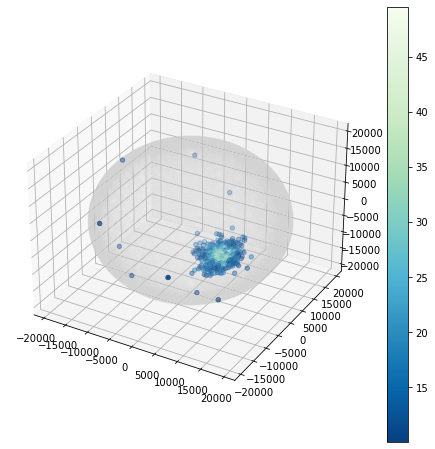

In [106]:
fig = plt.figure(figsize = (8, 8))
ax = fig.add_subplot(projection='3d')

ax.scatter(PMTPos_CD_LPMT["x"], PMTPos_CD_LPMT["y"], PMTPos_CD_LPMT["z"], color="lightgray", alpha=0.01)
points = ax.scatter(pmt_hit_x, pmt_hit_y, pmt_hit_z, c=pmt_hit_q, cmap="GnBu_r")
fig.colorbar(points)
plt.show()

In [6]:
random_evts = np.random.randint(0, 5000, 7)
R_array = np.array(PMTPos_CD_LPMT["R"][random_evts]) / 1000.

lpmt_x_array = []
lpmt_y_array = []
lpmt_z_array = []

for i in range(len(random_evts)):
    lpmt_x = np.array(PMTPos_CD_LPMT["x"][train_data[0, :][random_evts[i]]]) / 1000.
    lpmt_y = np.array(PMTPos_CD_LPMT["y"][train_data[0, :][random_evts[i]]]) / 1000.
    lpmt_z = np.array(PMTPos_CD_LPMT["z"][train_data[0, :][random_evts[i]]]) / 1000.

    lpmt_x_array.append(lpmt_x)
    lpmt_y_array.append(lpmt_y)
    lpmt_z_array.append(lpmt_z)

lpmt_charge_array = train_data[1, :][random_evts]
lpmt_fht_array    = train_data[2, :][random_evts]

event_edep_array  = np.array(train_label["edep"][random_evts])
event_Redep_array = np.array(train_label["edepR"][random_evts])
event_pos_x_array = np.array(train_label["edepX"][random_evts])
event_pos_y_array = np.array(train_label["edepY"][random_evts])
event_pos_z_array = np.array(train_label["edepZ"][random_evts])

modules.visualize_event.visualize_events(
    random_evts,
    R_array.mean(),
    lpmt_x_array,
    lpmt_y_array,
    lpmt_z_array,
    lpmt_charge_array,
    lpmt_fht_array,
    event_pos_x_array,
    event_pos_y_array,
    event_pos_z_array,
    event_edep_array,
    event_Redep_array,
    subplots       = True,
    colorscale_fht = "ice",
    cc_show        = True,
    cht_show       = True,
    save           = False
)